**Importing Libraries**

In [ ]:
import pandas as pd 
import numpy as np
import sklearn 
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
 
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler 
 
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from sklearn.ensemble import RandomForestRegressor 

import numpy as np
 

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
 
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score
from sklearn.metrics import f1_score,confusion_matrix
from sklearn.model_selection import train_test_split

**Reading training and testing dataset**

In [ ]:
train = pd.read_csv("/content/drive/MyDrive/Dhanushka/train.csv")
test = pd.read_csv("/content/drive/MyDrive/Dhanushka/test.csv")

In [ ]:
train.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


**Showing all rows and columns **

In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

**Splitting dataset into Numerical and Categorical Columns**

In [ ]:
cat_column = train.select_dtypes(include="object")
num_column = train.select_dtypes(exclude="object")
print("Categorical Columns is ",cat_column.shape)
print("Numerical Columns is ",num_column.shape)

Categorical Columns is  (1460, 43)
Numerical Columns is  (1460, 38)


**Checking Null values per Column**

In [ ]:
train[cat_column.keys()].isnull().sum()


MSZoning            0
Street              0
Alley            1369
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          8
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           37
BsmtCond           37
BsmtExposure       38
BsmtFinType1       37
BsmtFinType2       38
Heating             0
HeatingQC           0
CentralAir          0
Electrical          1
KitchenQual         0
Functional          0
FireplaceQu       690
GarageType         81
GarageFinish       81
GarageQual         81
GarageCond         81
PavedDrive          0
PoolQC           1453
Fence            1179
MiscFeature      1406
SaleType            0
SaleCondition       0
dtype: int64

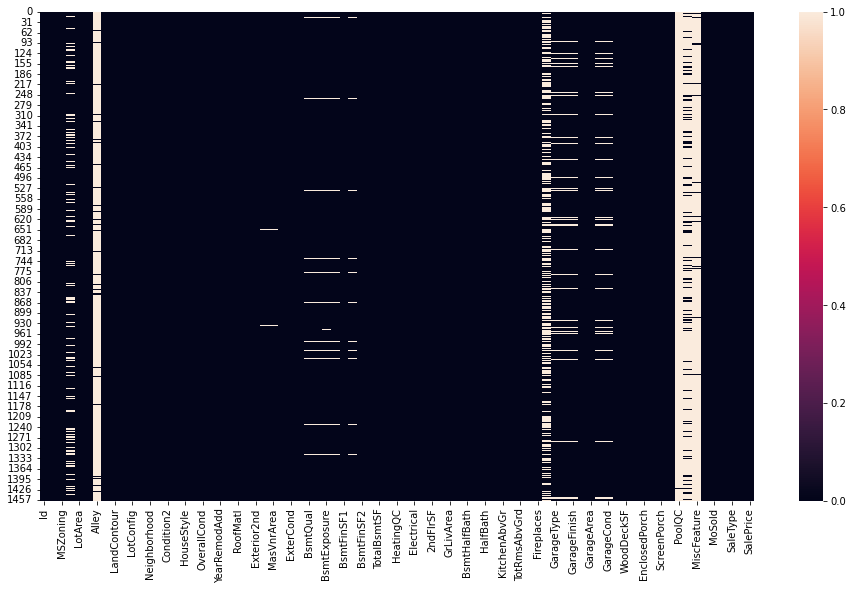

In [ ]:

plt.figure(figsize=(16,9))
sns.heatmap(train.isnull())
plt.show()

**Taking Statistical View of training and testing dataset**

In [ ]:
def Statistical_View(df):
    statistics_of_data = []
    for col in df.columns:
      statistics_of_data.append((col,
                                 df[col].nunique(),
                                 df[col].isnull().sum()*100/df.shape[0],

                                 df[col].dtype
                                 ))
    stats_df = pd.DataFrame(statistics_of_data, columns=['Feature', 'Uniq_val', 'missing_val', 'type'])
    return stats_df

In [ ]:
Statistical_View(train)

,Feature,Uniq_val,missing_val,type
0,Id,1460,0.000000,int64
1,MSSubClass,15,0.000000,int64
2,MSZoning,5,0.000000,object
3,LotFrontage,110,17.739726,float64
4,LotArea,1073,0.000000,int64
5,Street,2,0.000000,object
6,Alley,2,93.767123,object
7,LotShape,4,0.000000,object
8,LandContour,4,0.000000,object
9,Utilities,2,0.000000,object


In [ ]:
Statistical_View(test)

,Feature,Uniq_val,missing_val,type
0,Id,1459,0.000000,int64
1,MSSubClass,16,0.000000,int64
2,MSZoning,5,0.274160,object
3,LotFrontage,115,15.558602,float64
4,LotArea,1106,0.000000,int64
5,Street,2,0.000000,object
6,Alley,2,92.666210,object
7,LotShape,4,0.000000,object
8,LandContour,4,0.000000,object
9,Utilities,1,0.137080,object


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [ ]:
train.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [ ]:
test.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold
count,1459.000000,1459.000000,1232.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1444.000000,1458.000000,1458.000000,1458.000000,1458.000000,1459.000000,1459.000000,1459.000000,1459.000000,1457.000000,1457.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.00000,1381.000000,1458.000000,1458.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000
mean,2190.000000,57.378341,68.580357,9819.161069,6.078821,5.553804,1971.357779,1983.662783,100.709141,439.203704,52.619342,554.294925,1046.117970,1156.534613,325.967786,3.543523,1486.045922,0.434454,0.065202,1.570939,0.377656,2.854010,1.042495,6.385195,0.58122,1977.721217,1.766118,472.768861,93.174777,48.313914,24.243317,1.794380,17.064428,1.744345,58.167923,6.104181,2007.769705
std,421.321334,42.746880,22.376841,4955.517327,1.436812,1.113740,30.390071,21.130467,177.625900,455.268042,176.753926,437.260486,442.898624,398.165820,420.610226,44.043251,485.566099,0.530648,0.252468,0.555190,0.503017,0.829788,0.208472,1.508895,0.64742,26.431175,0.775945,217.048611,127.744882,68.883364,67.227765,20.207842,56.609763,30.491646,630.806978,2.722432,1.301740
min,1461.000000,20.000000,21.000000,1470.000000,1.000000,1.000000,1879.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,407.000000,0.000000,0.000000,407.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,0.00000,1895.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000
25%,1825.500000,20.000000,58.000000,7391.000000,5.000000,5.000000,1953.000000,1963.000000,0.000000,0.000000,0.000000,219.250000,784.000000,873.500000,0.000000,0.000000,1117.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.00000,1959.000000,1.000000,318.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,2007.000000
50%,2190.000000,50.000000,67.000000,9399.000000,6.000000,5.000000,1973.000000,1992.000000,0.000000,350.500000,0.000000,460.000000,988.000000,1079.000000,0.000000,0.000000,1432.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,0.00000,1979.000000,2.000000,480.000000,0.000000,28.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000
75%,2554.500000,70.000000,80.000000,11517.500000,7.000000,6.000000,2001.000000,2004.000000,164.000000,753.500000,0.000000,797.750000,1305.000000,1382.500000,676.000000,0.000000,1721.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.00000,2002.000000,2.000000,576.000000,168.000000,72.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000
max,2919.000000,190.000000,200.000000,56600.000000,10.000000,9.000000,2010.000000,2010.000000,1290.000000,4010.000000,1526.000000,2140.000000,5095.000000,5095.000000,1862.000000,1064.000000,5095.000000,3.000000,2.000000,4.000000,2.000000,6.000000,2.000000,15.000000,4.00000,2207.000000,5.000000,1488.000000,1424.000000,742.000000,1012.000000,360.000000,576.000000,800.000000,17000.000000,12.000000,2010.000000


In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1459 entries, 0 to 1458
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1459 non-null   int64  
 1   MSSubClass     1459 non-null   int64  
 2   MSZoning       1455 non-null   object 
 3   LotFrontage    1232 non-null   float64
 4   LotArea        1459 non-null   int64  
 5   Street         1459 non-null   object 
 6   Alley          107 non-null    object 
 7   LotShape       1459 non-null   object 
 8   LandContour    1459 non-null   object 
 9   Utilities      1457 non-null   object 
 10  LotConfig      1459 non-null   object 
 11  LandSlope      1459 non-null   object 
 12  Neighborhood   1459 non-null   object 
 13  Condition1     1459 non-null   object 
 14  Condition2     1459 non-null   object 
 15  BldgType       1459 non-null   object 
 16  HouseStyle     1459 non-null   object 
 17  OverallQual    1459 non-null   int64  
 18  OverallC

**Concatenate the training and testing DataSet**

In [ ]:
target = train['SalePrice']
test_ids = test['Id']
train1 = train.drop(['Id','SalePrice'], axis=1)
test1 = test.drop('Id', axis=1)
data1 = pd.concat([train1, test1], axis=0).reset_index(drop=True)
data1

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856,854,0,1710,1.0,0.0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2.0,548.0,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal
1,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262,0,0,1262,0.0,1.0,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2.0,460.0,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal
2,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920,866,0,1786,1.0,0.0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2.0,608.0,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal
3,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961,756,0,1717,1.0,0.0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3.0,642.0,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml
4,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1.0,0.0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3.0,836.0,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal
5,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732.0,Unf,0.0,64.0,796.0,GasA,Ex,Y,SBrkr,796,566,0,1362,1.0,0.0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2.0,480.0,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal
6,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369.0,Unf,0.0,317.0,1686.0,GasA,Ex,Y,SBrkr,1694,0,0,1694,1.0,0.0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2.0,636.0,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal
7,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859.0,BLQ,32.0,216.0,1107.0,GasA,Ex,Y,SBrkr,1107,983,0,2090,1.0,0.0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2.0,484.0,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal
8,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0.0,Unf,0.0,952.0,952.0,GasA,Gd,Y,FuseF,1022,752,0,1774,0.0,0.0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2.0,468.0,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml
9,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,

**separating the list of Numerical Features**

In [ ]:
num_features = ['1stFlrSF',
 '2ndFlrSF',
 '3SsnPorch',
 'BedroomAbvGr',
 'BsmtFinSF1',
 'BsmtFinSF2',
 'BsmtFullBath',
 'BsmtHalfBath',
 'BsmtUnfSF',
 'EnclosedPorch',
 'Fireplaces',
 'FullBath',
 'GarageArea',
 'GarageCars',
 'GrLivArea',
 'HalfBath',
 'KitchenAbvGr',
 'LotArea',
 'LotFrontage',
 'LowQualFinSF',
 'MasVnrArea',
 'MiscVal',
 'OpenPorchSF',
 'PoolArea',
 'ScreenPorch',
 'TotRmsAbvGrd',
 'TotalBsmtSF',
 'WoodDeckSF']

**b.)Visualizations**

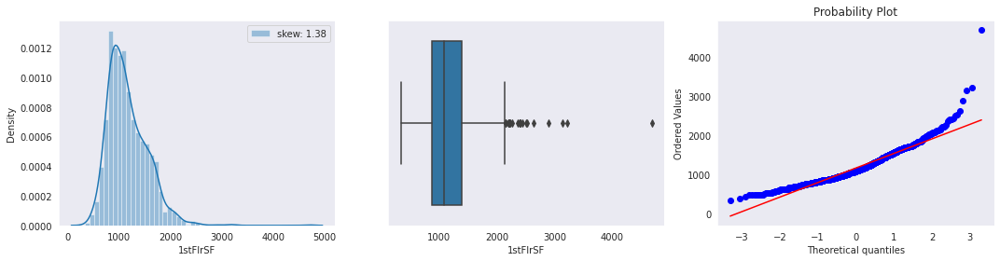

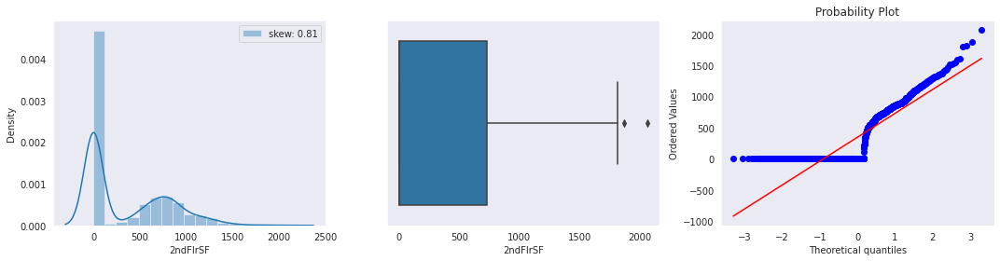

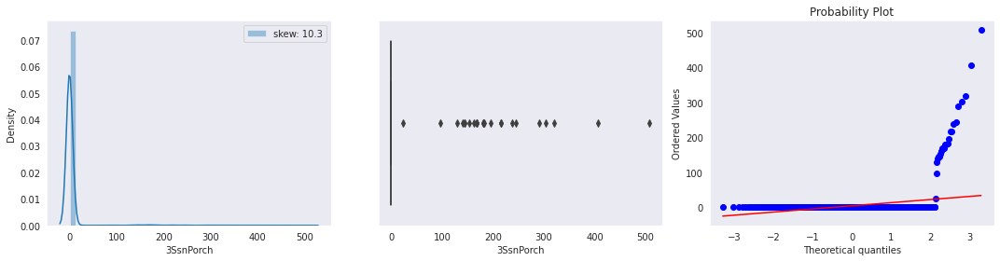

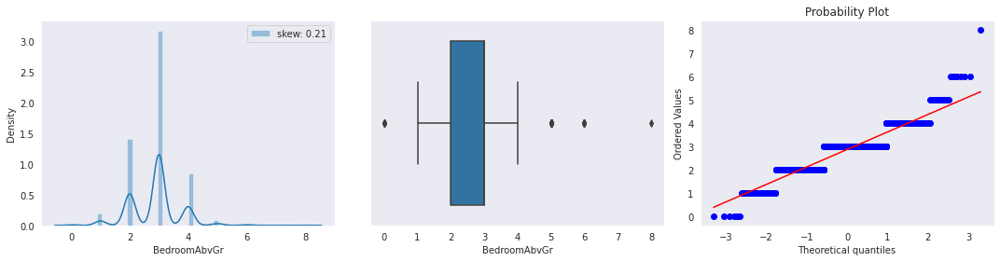

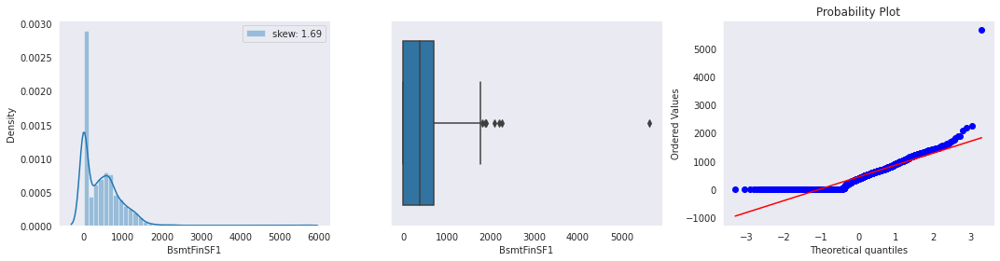

...

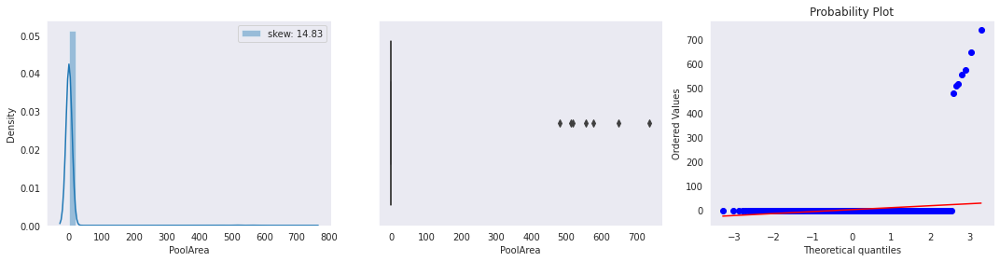

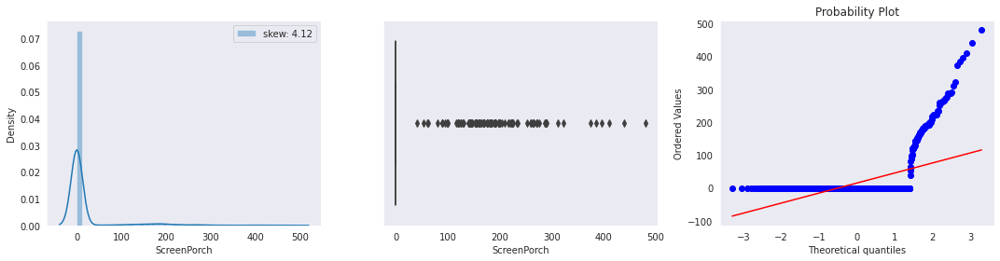

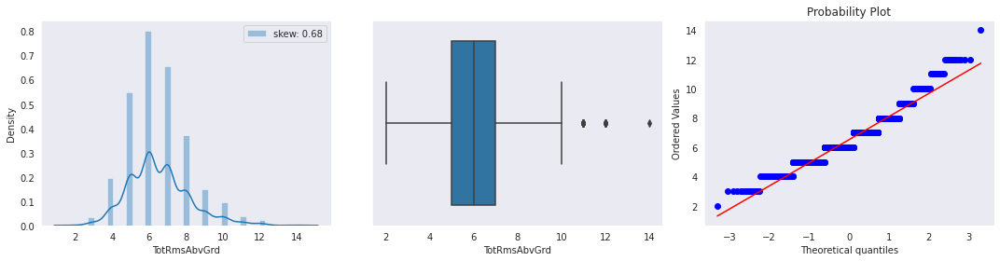

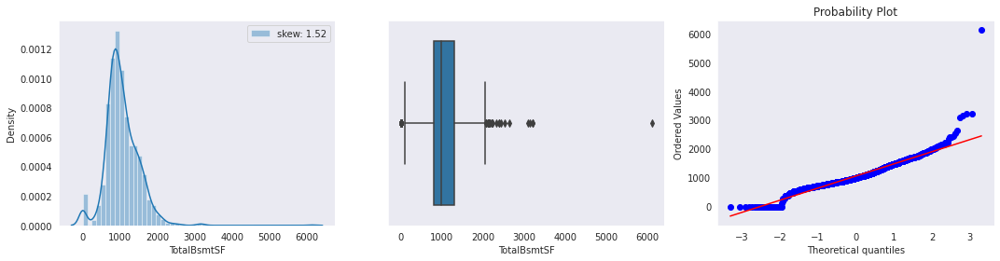

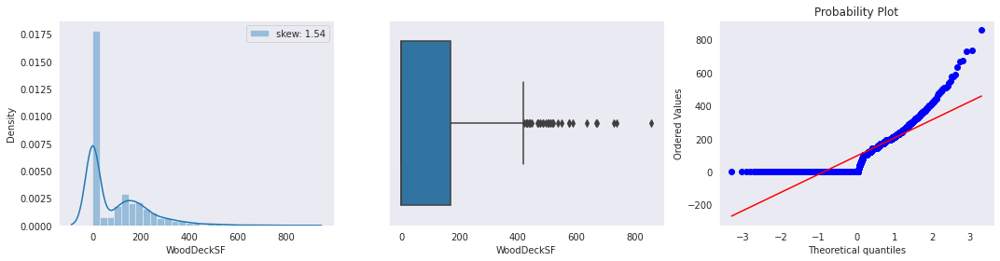

In [ ]:
import warnings 
warnings.filterwarnings(action='ignore')
import scipy.stats as stats
df =train.copy()
import seaborn as sns
sns.set_style('dark')
for col in num_features:
    try:
        plt.figure(figsize=(15,4))
        plt.subplot(131)
        sns.distplot(df[col], label="skew: " + str(np.round(df[col].skew(),2)))
        plt.legend()
        plt.subplot(132)
        sns.boxplot(df[col])
        plt.subplot(133)
        stats.probplot(df[col],dist="norm", plot=plt)
        plt.tight_layout()
        plt.show()
    except:
        print(col)

In [ ]:
data1.isnull().sum().sum()

13965

**C.Preprocessing**

**a.Filling with NAN values**

In [ ]:
na_columns=[
    'Alley',
    'BsmtQual',
    'BsmtCond',
    'BsmtExposure',
    'BsmtFinType1',
    'BsmtFinType2',
    'FireplaceQu',
    'GarageType',
    'GarageFinish',
    'GarageQual',
    'GarageCond',
    'PoolQC',
    'Fence',
    'MiscFeature'
]

data1[na_columns] = data1[na_columns].fillna("Na")

**b.Filling with Mode**

In [ ]:
for column in [
    'MSZoning',
    'Utilities',
    'Exterior1st',
    'Exterior2nd',
    'MasVnrType',
    'Electrical',
    'KitchenQual',
    'Functional',
    'SaleType'
]:
    data1[column] = data1[column].fillna(data1[column].mode()[0])

**c.Filling with mean**

In [ ]:
mean_columns= data1.select_dtypes(np.number).isna().columns
data1[mean_columns]=data1[mean_columns].fillna(np.mean(data1[mean_columns]))

**.Converting Categorical into Numbers**

In [ ]:
data2 = data1.copy()
from sklearn.preprocessing import LabelEncoder
for column in data2.select_dtypes(object).columns:
    label = LabelEncoder()
    data2[column] = label.fit_transform(data2[column])

**Removing Outliers using IQR**

In [ ]:
def iqr_removing(df, cols, factor):
    
    for col in cols:
        
        try:

          q1 = df[col].quantile(0.25)
          q3 = df[col].quantile(0.75)
        
          iqr = q3 - q1
        
          upper_whisker = q3 + (factor*iqr)
          lower_whisker = q1 - (factor*iqr)

          df[col] = np.where(df[col]>upper_whisker, upper_whisker,
                 np.where(df[col]<lower_whisker, lower_whisker, df[col]))
        except:
          print(col)
          pass
    return df      
        
data1 = iqr_removing(data1, num_features, 1.5)
 

**.Feature Scaling**

In [ ]:
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
scaler = StandardScaler()
data2 = pd.DataFrame(scaler.fit_transform(data2),columns=data1.columns)
data2.head(4)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,0.067331,-0.042157,-0.202068,-0.217879,0.064249,0.05533,0.746669,0.316671,-0.018512,0.588555,-0.21626,-1.248476,-0.046258,-0.009816,-0.419174,1.031721,0.646183,-0.507284,1.046258,0.896833,-0.482926,-0.116923,0.742788,0.750334,-1.267151,0.525202,-0.755793,0.376461,0.834618,-0.540027,0.333532,0.676842,-0.529329,0.580907,0.353536,-0.29313,-0.934863,-0.444328,-0.103206,-0.880324,0.26829,0.300615,-0.773861,1.207379,-0.101197,0.413547,1.087023,-0.249895,0.781366,1.232599,0.169927,-0.207698,-0.415996,0.986849,0.256806,-0.924311,-0.062540,-0.767783,1.000929,0.104581,0.306528,0.348900,0.326691,0.293549,0.31503,-0.740760,0.200006,-0.359601,-0.103331,-0.285935,-0.06315,0.053507,0.464024,-0.181028,-0.089592,-1.552184,0.157646,0.319311,0.204967
1,-0.873616,-0.042157,0.501870,-0.072044,0.064249,0.05533,0.746669,0.316671,-0.018512,-0.658174,-0.21626,1.941064,-1.190557,-0.009816,-0.419174,-0.536817,-0.063185,2.188279,0.154764,-0.395604,-0.482926,-0.116923,-0.507795,-0.657990,0.384843,-0.572250,0.668455,0.376461,-0.541017,-0.540027,0.333532,-1.260121,-1.424268,1.178112,0.353536,-0.29313,-0.629896,0.477111,-0.103206,-0.880324,0.26829,0.300615,0.261075,-0.785025,-0.101197,-0.471891,-0.819679,3.822419,0.781366,-0.756321,0.169927,-0.207698,0.782713,-0.287758,0.256806,0.623632,1.684379,-0.767783,-0.085000,0.104581,0.306528,-0.059792,0.326691,0.293549,0.31503,1.614879,-0.702843,-0.359601,-0.103331,-0.285935,-0.06315,0.053507,0.464024,-0.181028,-0.089592,-0.446925,-0.602962,0.319311,0.204967
2,0.067331,-0.042157,-0.061280,0.137197,0.064249,0.05533,-1.381776,0.316671,-0.018512,0.588555,-0.21626,-1.248476,-0.046258,-0.009816,-0.419174,1.031721,0.646183,-0.507284,0.980221,0.848965,-0.482926,-0.116923,0.742788,0.750334,-1.267151,0.334828,-0.755793,0.376461,0.834618,-0.540027,0.333532,-0.614467,-0.529329,0.097873,0.353536,-0.29313,-0.288516,-0.299076,-0.103206,-0.880324,0.26829,0.300615,-0.610718,1.235375,-0.101197,0.563755,1.087023,-0.249895,0.781366,1.232599,0.169927,-0.207698,-0.415996,-0.287758,0.256806,0.623632,1.684379,-0.767783,0.920490,0.104581,0.306528,0.627553,0.326691,0.293549,0.31503,-0.740760,-0.081209,-0.359601,-0.103331,-0.285935,-0.06315,0.053507,0.464024,-0.181028,-0.089592,1.026753,0.157646,0.319311,0.204967
3,0.302568,-0.042157,-0.436714,-0.078385,0.064249,0.05533,-1.381776,0.316671,-0.018512,-1.904903,-0.21626,-1.080605,-0.046258,-0.009816,-0.419174,1.031721,0.646183,-0.507284,-1.859351,-0.682812,-0.482926,-0.116923,1.055433,1.313664,0.384843,-0.572250,0.668455,0.376461,-1.916652,1.003134,-2.737700,0.676842,-1.424268,-0.494941,0.353536,-0.29313,-0.047275,-0.671283,-0.103206,0.267617,0.26829,0.300615,-0.506205,0.978742,-0.101197,0.427382,1.087023,-0.249895,-1.027363,-0.756321,0.169927,-0.207698,-0.415996,0.349546,0.256806,0.623632,-0.935999,1.302093,0.799831,0.936382,1.619961,0.785457,0.326691,0.293549,0.31503,-0.740760,-0.184815,3.874967,-0.103331,-0.285935,-0.06315,0.053507,0.464024,-0.181028,-0.089592,-1.552184,-1.363569,0.319311,-3.505415


In [ ]:
 
data3 =  data2.copy()

,PCA1,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,PCA11,PCA12,PCA13,PCA14,PCA15,PCA16,PCA17,PCA18,PCA19,PCA20,PCA21,PCA22,PCA23,PCA24,PCA25,PCA26,PCA27,PCA28,PCA29,PCA30,PCA31,PCA32,PCA33,PCA34,PCA35,PCA36,PCA37,PCA38,PCA39,PCA40,PCA41,PCA42,PCA43,PCA44,PCA45,PCA46,PCA47,PCA48,PCA49,PCA50,PCA51,PCA52,PCA53,PCA54,PCA55,PCA56,PCA57,PCA58,PCA59,PCA60
0,2.300062,0.886797,-1.801766,1.329963,-0.541905,1.242968,-0.610592,-0.348716,1.006901,-1.192847,-0.481517,0.004179,0.650558,0.198210,0.639203,-0.892321,0.243972,0.977092,-0.081077,0.570513,-0.196519,-0.578374,0.004756,-0.019345,-0.102039,-0.250206,-0.495081,0.128815,-1.160749,0.416187,1.495881,-0.496302,0.090330,-0.282903,-0.099032,0.206719,-0.451614,-0.353614,-0.385522,0.166999,0.746313,-0.167810,-0.153850,-0.444966,-0.241054,0.179612,-0.153593,-0.015165,0.059835,0.416683,0.833691,0.418313,-0.314388,-0.482684,0.385294,-0.068713,0.311518,-0.235175,-0.699674,0.141981
1,0.335112,-2.210344,0.738923,0.761323,-0.851953,-0.258711,-0.958579,0.134030,-0.107919,0.020447,0.373840,0.408846,-1.312537,-0.648285,-0.490940,2.152451,0.531977,-0.835689,0.456780,-1.064418,-0.248557,-1.226314,2.981103,-0.143150,1.394393,1.220094,-0.696757,-0.960895,-0.421523,0.322283,-1.437416,0.068468,-0.221803,-0.153299,0.844469,0.079918,-0.400837,0.835506,-1.187837,0.827212,-0.681670,0.332757,-0.889764,0.217255,-1.165727,-0.544497,-1.091082,-0.230541,0.303198,-0.306763,-0.902906,0.475120,-0.075698,0.623923,0.204120,-0.807560,-0.081200,0.642170,0.224894,0.009741
2,2.762536,0.536549,-1.477796,1.528736,-0.749125,1.303965,0.010287,-0.923192,1.192435,-0.295624,-0.600039,0.740253,0.507372,-0.062726,0.321708,-0.263108,-0.475711,-0.082983,-0.150795,-0.406329,0.270074,0.074678,0.171769,0.758959,0.372160,-0.148164,-0.019088,1.009717,-0.353076,0.049892,-0.077840,-0.113891,0.377766,0.653199,-0.366677,-0.291250,0.524012,-1.076068,-0.028351,-0.437034,0.344414,-0.555930,-0.529664,0.186245,-0.216356,0.609418,1.219161,0.001333,0.344820,-0.028656,0.413028,0.231864,-0.217361,-0.493356,0.454726,-0.156784,-0.103040,-0.131711,-0.099447,0.000977
3,-1.310791,1.006880,1.328259,0.669500,-0.358185,1.298273,-0.241447,0.093462,0.816791,-0.609704,-0.995614,-1.769264,2.071817,-1.213578,-1.874863,1.737642,-0.248568,0.913919,-0.637301,-0.886665,1.248524,0.911606,-2.105938,0.908690,0.819620,0.450070,-0.865434,-1.454096,-1.187669,-0.103080,0.161050,-0.698818,-0.453592,-0.444732,-2.394620,-1.109038,0.036865,-0.732817,-0.901044,2.123121,-0.866363,1.712461,0.693477,-0.936175,1.630733,0.593592,0.722939,0.260956,0.822683,0.656532,0.970895,0.421215,1.929629,0.323855,-0.295996,0.787994,-1.420792,-0.296805,-0.869142,-0.201528
4,5.005159,1.407352,0.429831,2.092751,-0.471654,0.810333,-0.051443,-1.172894,0.991484,-0.939528,-0.514433,0.496678,0.488450,-0.745709,-0.248361,0.705521,-0.296823,-1.076730,-0.622769,-0.283638,0.587061,0.064143,-0.104787,0.081972,0.826871,0.319138,0.377283,1.085299,0.255048,0.178368,-0.413212,0.356569,0.299733,0.363218,0.124572,-0.272274,0.580616,-1.508209,-0.031988,-0.353946,-0.239817,-0.583247,-0.279519,0.536489,-0.093527,0.633784,0.241664,-0.379544,0.168132,-0.487624,-0.200249,0.308991,-0.286751,-0.258268,-0.204218,-0.648320,0.043268,0.300535,0.905717,0.204437
5,0.696927,-2.312571,-1.692210,-0.045891,-1.371920,1.943819,0.594595,-0.400365,1.990228,-0.751980,1.400216,-1.281616,-3.833242,0.641854,2.145448,1.430307,-4.113155,1.673163,1.143813,0.143574,-3.688942,-2.592694,-3.301379,1.203587,4.384313,-4.524483,7.335801,2.692297,-2.242799,1.060347,0.337388,0.255141,-3.032472,0.098897,-0.451710,-1.224860,0.173890,0.849300,0.315258,0.482120,1.544493,0.644795,1.360551,-0.574422,1.272112,0.542243,0.587083,0.534296,-0.007043,-2.194205,-0.191818,-0.783900,-1.866757,-0.636097,0.540770,0.822718,0.999387,1.250535,1.225561,-0.111176
6,4.242544,-1.646204,0.170279,-2.005456,0.616930,0.858562,-0.699010,0.033878,0.059660,-1.027000,-0.985222,-0.785596,-0.638997,-0.821662,-1.115188,-0.218929,-0.709555,-0.948193,0.516036,0.639826,0.424740,-0.299645,1.128

**Spliting into training and testing**

In [ ]:
train_final = data3.loc[:train.index.max(), :].copy()
test_final = data3.loc[train.index.max() + 1:, :].reset_index(drop=True).copy()

**E.Feature Selection**

In [ ]:
def correlation(dataset, threshold):
    col_corr = set() # Set of all the names of deleted columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (corr_matrix.iloc[i, j] >= threshold) and (corr_matrix.columns[j] not in col_corr):
                colname = corr_matrix.columns[i] # getting the name of column
                col_corr.add(colname)
                if colname in dataset.columns:
                    del dataset[colname] # deleting the column from the dataset

    return col_corr
 
x= correlation(train_final, 0.8)

In [ ]:
test_final.drop(x,axis=1,inplace=True)

In [ ]:
test_final.shape

(1459, 60)

In [ ]:
target = np.log(target)

In [ ]:
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import make_scorer, r2_score

def test_model(model, X_train=train_final, y_train=target):
    cv = KFold(n_splits = 3, shuffle=True, random_state = 45)
    r2 = make_scorer(r2_score)
    r2_val_score = cross_val_score(model, X_train, y_train, cv=cv, scoring = r2)
    score = [r2_val_score.mean()]
    return score
 

[0.8282479789573486]

In [ ]:
from sklearn.ensemble import RandomForestRegressor
rf_reg = RandomForestRegressor(n_estimators = 100, random_state=51)
test_model(rf_reg)

[0.8482889380698359]

In [ ]:
from sklearn.tree import DecisionTreeRegressor
dt_reg = DecisionTreeRegressor()
test_model(dt_reg)

[0.7062483978279731]